In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import numpy as np
import pandas as pd
from tqdm import tqdm
import chromATAC as ca
from chromATAC.integrated import IntData
from functools import reduce
import matplotlib.pyplot as plt
from tqdm import tqdm

In [3]:
cnv_meta = pd.read_csv("/cluster/home/t124771uhn/data/CNVAR/summary.ascatv3TCGA.penalty70.hg38.tsv", sep='\t')

,name,patient,cancer_type,sex,barcodeTumour,barcodeNormal,tumour_mapd,normal_mapd,GC_correction_before,GC_correction_after
0,TCGA-02-0001,TCGA-02-0001,GBM,XX,TCGA-02-0001-01C-01D-0182-01,TCGA-02-0001-10A-01D-0182-01,0.2828,0.2716,50bp=0.1388 / 5kb=0.1201,50bp=0 / 5kb=0
1,TCGA-02-0003,TCGA-02-0003,GBM,XY,TCGA-02-0003-01A-01D-0182-01,TCGA-02-0003-10A-01D-0182-01,0.2744,0.3040,25bp=0.0571 / 10kb=0.0383,25bp=0 / 10kb=0
2,TCGA-02-0006,TCGA-02-0006,GBM,XX,TCGA-02-0006-01B-01D-0182-01,TCGA-02-0006-10A-01D-0182-01,0.2643,0.2938,1kb=0.0347 / 5kb=0.0425,1kb=0 / 5kb=0
3,TCGA-02-0007,TCGA-02-0007,GBM,XX,TCGA-02-0007-01A-01D-0182-01,TCGA-02-0007-10A-01D-0182-01,0.2245,0.2923,25bp=0.1397 / 5kb=0.0343,25bp=0 / 5kb=0
4,TCGA-02-0009,TCGA-02-0009,GBM,XX,TCGA-02-0009-01A-01D-0182-01,TCGA-02-0009-10A-01D-0182-01,0.2317,0.2586,25bp=0.0962 / 5kb=0.0786,25bp=0 / 5kb=0
...,...,...,...,...,...,...,...,...,...,...
10672,TCGA-ZS-A9CF-a,TCGA-ZS-A9CF,LIHC,XY,TCGA-ZS-A9CF-01A-11D-A381-01,TCGA-ZS-A9CF-10A-01D-A384-01,0.2320,0.4000,1kb=0.1722 / 20kb=0.1752,1kb=0 / 20kb=0
10673,TCGA-ZS-A9CG,TCGA-ZS-A9CG,LIHC,XY,TCGA-ZS-A9CG-01A-11D-A36W-01,TCGA-ZS-A9CG-10A-01D-A36Z-01,0.2495,0.3668,1kb=0.1 / 50kb=0.1065,1kb=0 / 50kb=0
10674,TCGA-ZT-A8OM,TCGA-ZT-A8OM,THYM,XX,TCGA-ZT-A8OM-01A-11D-A427-01,TCGA-ZT-A8OM-10A-01D-A42A-01,0.2262,0.4348,25bp=0.1273 / 50kb=0.1215,25bp=0 / 50kb=0
10675,TCGA-ZU-A8S4-a,TCGA-ZU-A8S4,CHOL,XY,TCGA-ZU-A8S4-01A-11D-A416-01,TCGA-ZU-A8S4-10A-01D-A419-01,0.1951,0.3621,25bp=0.0751 / 100kb=0.0508,25bp=0 / 100kb=0


In [19]:
cnv_meta.iloc[:, 10:20]

,RT_correction_before,RT_correction_after,n_het_SNP,n_segs_logR,n_segs_BAF,n_segs_logRBAF_diff,frac_homo,purity,ploidy,goodness_of_fit
0,Mcf7=0.0568,Mcf7=0,239777,63,48,15,0.0097,0.58,2.3327,86.9607
1,Mcf7=0.0385,Mcf7=0,236585,44,23,21,0.0624,0.81,1.9204,99.6491
2,Mcf7=0.0323,Mcf7=0,239079,96,80,16,0.0051,0.39,3.9648,93.5118
3,Mcf7=0.0207,Mcf7=0,240376,61,40,21,0.1046,0.89,1.8990,99.5851
4,K562=0.0426,K562=0,240713,128,103,25,0.0297,0.82,1.9870,98.3706
...,...,...,...,...,...,...,...,...,...,...
10672,K562=0.1088,K562=0,247143,311,272,39,0.0906,0.84,1.8709,99.6561
10673,Hepg2=0.0802,Hepg2=0,242501,34,16,18,0.0654,0.58,4.2103,96.6995
10674,Sknsh=0.0527,Sknsh=0,241410,34,3,31,0.0025,1.00,1.9999,99.8549
10675,Hepg2=0.0733,Hepg2=0,242518,86,31,55,0.0354,0.30,1.7881,93.8442


In [20]:
cnv_meta.iloc[:, 20:]

,n_segs,segs_size,n_segs_1kSNP,homdel_segs,homdel_largest,homdel_size,homdel_fraction,LOH,mode_minA,mode_majA,WGD,GI,QC
0,56,2935295636,0.233550,1,351838,351838,0.000120,0.2044,1,1,0,0.6177,Pass
1,40,2945709047,0.169072,0,0,0,0.000000,0.0969,1,1,0,0.1548,Pass
2,92,2924037522,0.384810,1,1475622,1475622,0.000505,0.1230,2,2,1,0.2603,Pass
3,56,2945620338,0.232968,0,0,0,0.000000,0.1988,1,1,0,0.2333,Pass
4,109,2945475297,0.452821,2,3187692,4363726,0.001482,0.0909,1,1,0,0.1688,Pass
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10672,291,2941976142,1.177456,5,290286,721549,0.000245,0.1611,1,1,0,0.2327,Pass
10673,30,2913779184,0.123711,0,0,0,0.000000,0.0885,2,2,1,0.2499,Pass
10674,27,2945730012,0.111843,0,0,0,0.000000,0.0001,1,1,0,0.0001,Likely normal
10675,77,2945650821,0.317502,3,2884015,3808092,0.001293,0.1825,1,1,0,0.1997,Pass


In [17]:
cnv_meta[cnv_meta['cancer_type']=='BRCA']

,name,patient,cancer_type,sex,barcodeTumour,barcodeNormal,tumour_mapd,normal_mapd,GC_correction_before,GC_correction_after,...,homdel_segs,homdel_largest,homdel_size,homdel_fraction,LOH,mode_minA,mode_majA,WGD,GI,QC
1331,TCGA-3C-AAAU,TCGA-3C-AAAU,BRCA,XX,TCGA-3C-AAAU-01A-11D-A41E-01,TCGA-3C-AAAU-10A-01D-A41E-01,0.1793,0.3603,25bp=0.0083 / 100kb=0.0412,25bp=0 / 100kb=0,...,0,0,0,0.000000,0.1555,1,2,1,0.9779,Pass
1332,TCGA-3C-AALI,TCGA-3C-AALI,BRCA,XX,TCGA-3C-AALI-01A-11D-A41E-01,TCGA-3C-AALI-10A-01D-A41E-01,0.2275,0.3882,1kb=0.048 / 100kb=0.0667,1kb=0 / 100kb=0,...,0,0,0,0.000000,0.1857,1,2,1,0.7506,Pass
1333,TCGA-3C-AALJ,TCGA-3C-AALJ,BRCA,XX,TCGA-3C-AALJ-01A-31D-A41E-01,TCGA-3C-AALJ-10A-01D-A41E-01,0.1904,0.3430,25bp=0.0425 / 5kb=0.0087,25bp=0 / 5kb=0,...,0,0,0,0.000000,0.1373,2,2,1,0.6733,Pass
1334,TCGA-3C-AALK,TCGA-3C-AALK,BRCA,XX,TCGA-3C-AALK-01A-11D-A41E-01,TCGA-3C-AALK-10A-01D-A41E-01,0.1836,0.3613,25bp=0.0543 / 100kb=0.0313,25bp=0 / 100kb=0,...,0,0,0,0.000000,0.0307,1,1,0,0.0842,Pass
1504,TCGA-4H-AAAK,TCGA-4H-AAAK,BRCA,XX,TCGA-4H-AAAK-01A-12D-A41E-01,TCGA-4H-AAAK-10A-01D-A41E-01,0.2349,0.3442,25bp=0.1758 / 5kb=0.1161,25bp=0 / 5kb=0,...,0,0,0,0.000000,0.0605,2,2,1,0.2513,Pass
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10244,TCGA-WT-AB41,TCGA-WT-AB41,BRCA,XX,TCGA-WT-AB41-01A-11D-A41E-01,TCGA-WT-AB41-10A-01D-A41E-01,0.1910,0.3558,1kb=0.0674 / 10kb=0.0757,1kb=0 / 10kb=0,...,0,0,0,0.000000,0.2346,1,1,0,0.3370,Pass
10446,TCGA-XX-A899-b,TCGA-XX-A899,BRCA,XX,TCGA-XX-A899-01A-11D-A36I-01,TCGA-XX-A899-10A-01D-A40C-01,0.2679,0.3770,25bp=0.0633 / 5kb=0.037,25bp=0 / 5kb=0,...,0,0,0,0.000000,0.0991,1,1,0,0.1883,Pass
10447,TCGA-XX-A89A,TCGA-XX-A89A,BRCA,XX,TCGA-XX-A89A-01A-11D-A36I-01,TCGA-XX-A89A-10A-01D-A36L-01,0.1914,0.3371,25bp=0.0471 / 10kb=0.0163,25bp=0 / 10kb=0,...,0,0,0,0.000000,0.1812,3,3,1+,0.7853,Pass
10536,TCGA-Z7-A8R5,TCGA-Z7-A8R5,BRCA,XX,TCGA-Z7-A8R5-01A-42D-A41E-01,TCGA-Z7-A8R5-10A-01D-A41E-01,0.2073,0.3527,25bp=0.1567 / 10kb=0.1856,25bp=0 / 10kb=0,...,0,0,0,0.000000,0.0083,1,1,0,0.3329,Pass


In [15]:
cnv_meta[cnv_meta['cancer_type']=='BRCA']['barcodeTumour'].apply(lambda x: x.split('-')[3]).unique()

array(['01A', '01B'], dtype=object)

In [9]:
cnv_meta['barcodeTumour']

0        TCGA-02-0001-01C-01D-0182-01
1        TCGA-02-0003-01A-01D-0182-01
2        TCGA-02-0006-01B-01D-0182-01
3        TCGA-02-0007-01A-01D-0182-01
4        TCGA-02-0009-01A-01D-0182-01
                     ...             
10672    TCGA-ZS-A9CF-01A-11D-A381-01
10673    TCGA-ZS-A9CG-01A-11D-A36W-01
10674    TCGA-ZT-A8OM-01A-11D-A427-01
10675    TCGA-ZU-A8S4-01A-11D-A416-01
10676    TCGA-ZX-AA5X-01A-11D-A42N-01
Name: barcodeTumour, Length: 10677, dtype: object

In [7]:
cnv_meta.name.unique()[:20]

array(['TCGA-02-0001', 'TCGA-02-0003', 'TCGA-02-0006', 'TCGA-02-0007',
       'TCGA-02-0009', 'TCGA-02-0010', 'TCGA-02-0011', 'TCGA-02-0014',
       'TCGA-02-0015', 'TCGA-02-0016', 'TCGA-02-0021', 'TCGA-02-0023',
       'TCGA-02-0024', 'TCGA-02-0025', 'TCGA-02-0026', 'TCGA-02-0027',
       'TCGA-02-0028', 'TCGA-02-0033', 'TCGA-02-0034', 'TCGA-02-0037'],
      dtype=object)

<ul>
  <li>GBM - <a href="https://en.wikipedia.org/wiki/Glioblastoma_Multiforme">Glioblastoma Multiforme</a></li>
  <li>OV - <a href="https://en.wikipedia.org/wiki/Ovarian_cancer">Ovarian Cancer</a></li>
  <li>LUAD - <a href="https://en.wikipedia.org/wiki/Lung_adenocarcinoma">Lung Adenocarcinoma</a></li>
  <li>LUSC - <a href="https://en.wikipedia.org/wiki/Lung_squamous_cell_carcinoma">Lung Squamous Cell Carcinoma</a></li>
  <li>PRAD - <a href="https://en.wikipedia.org/wiki/Prostate_cancer">Prostate Adenocarcinoma</a></li>
  <li>UCEC - <a href="https://en.wikipedia.org/wiki/Endometrial_cancer">Uterine Corpus Endometrial Carcinoma</a></li>
  <li>BLCA - <a href="https://en.wikipedia.org/wiki/Bladder_cancer">Bladder Urothelial Carcinoma</a></li>
  <li>TGCT - <a href="https://en.wikipedia.org/wiki/Testicular_cancer">Testicular Germ Cell Tumor</a></li>
  <li>ESCA - <a href="https://en.wikipedia.org/wiki/Esophageal_carcinoma">Esophageal Carcinoma</a></li>
  <li>PAAD - <a href="https://en.wikipedia.org/wiki/Pancreatic_cancer">Pancreatic Adenocarcinoma</a></li>
  <li>KIRP - <a href="https://en.wikipedia.org/wiki/Renal_papillary_cell_carcinoma">Kidney Renal Papillary Cell Carcinoma</a></li>
  <li>LIHC - <a href="https://en.wikipedia.org/wiki/Hepatocellular_carcinoma">Liver Hepatocellular Carcinoma</a></li>
  <li>CESC - <a href="https://en.wikipedia.org/wiki/Cervical_cancer">Cervical Squamous Cell Carcinoma and Endocervical Adenocarcinoma</a></li>
  <li>SARC - <a href="https://en.wikipedia.org/wiki/Sarcoma">Sarcoma</a></li>
  <li>BRCA - <a href="https://en.wikipedia.org/wiki/Breast_cancer">Breast Invasive Carcinoma</a></li>
  <li>THYM - <a href="https://en.wikipedia.org/wiki/Thymoma">Thymoma</a></li>
  <li>MESO - <a href="https://en.wikipedia.org/wiki/Mesothelioma">Mesothelioma</a></li>
  <li>COAD - <a href="https://en.wikipedia.org/wiki/Colorectal_cancer">Colon Adenocarcinoma</a></li>
  <li>STAD - <a href="https://en.wikipedia.org/wiki/Stomach_cancer">Stomach Adenocarcinoma</a></li>
  <li>SKCM - <a href="https://en.wikipedia.org/wiki/Melanoma">Skin Cutaneous Melanoma</a></li>
  <li>CHOL - <a href="https://en.wikipedia.org/wiki/Cholangiocarcinoma">Cholangiocarcinoma</a></li>
  <li>KIRC - <a href="https://en.wikipedia.org/wiki/Renal_cell_carcinoma">Kidney Renal Clear Cell Carcinoma</a></li>
  <li>THCA - <a href="https://en.wikipedia.org/wiki/Thyroid_cancer">Thyroid Carcinoma</a></li>
  <li>HNSC - <a href="https://en.wikipedia.org/wiki/Head_and_neck_cancer">Head and Neck Squamous Cell Carcinoma</a></li>
  <li>LAML - <a href="https://en.wikipedia.org/wiki/Acute_myeloid_leukemia">Acute Myeloid Leukemia</a></li>
  <li>READ - <a href="https://en.wikipedia.org/wiki/Rectal_cancer">Rectum Adenocarcinoma</a></li>
  <li>LGG - <a href="https://en.wikipedia.org/wiki/Glioma">Lower Grade Glioma</a></li>
  <li>DLBC - <a href="https://en.wikipedia.org/wiki/Diffuse_large_B-cell_lymphoma">Diffuse Large B-Cell Lymphoma</a></li>
  <li>KICH - <a href="https://en.wikipedia.org/wiki/Kidney_chromophobe">Kidney Chromophobe</a></li>
  <li>UCS - <a href="https://en.wikipedia.org/wiki/Uterine_carcinosarcoma">Uterine Carcinosarcoma</a></li>
  <li>ACC - <a href="https://en.wikipedia.org/wiki/Adrenocortical_cancer">Adrenocortical Carcinoma</a></li>
  <li>PCPG - <a href="https://en.wikipedia.org/wiki/Pheochromocytoma">Pheochromocytoma and Paraganglioma</a></li>
  <li>UVM - <a href="https://en.wikipedia.org/wiki/Uveal_melanoma">Uveal Melanoma</a></li>
</ul>


# initialize an Integrated Data Object

In [4]:
ind = IntData()

## Add layers to ind object 

### CNVAR

In [5]:
ind.add_layer("CNVAR", input='/cluster/home/t124771uhn/data/CNVAR/segments/bed', feature_type='signal', resolutions=[1e06, 1e07])

loading files from: /cluster/home/t124771uhn/data/CNVAR/segments/bed


100%|██████████| 10678/10678 [00:27<00:00, 391.91it/s]


In [6]:
cnv_meta = pd.read_csv("/cluster/home/t124771uhn/data/CNVAR/summary.ascatv3TCGA.penalty70.hg38.tsv", sep='\t')

def Cnv_cancertype(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {i:cancer for i, cancer in enumerate(cnv_meta['cancer_type'].unique())}
    con =  {cancer:i for i, cancer in enumerate(cnv_meta['cancer_type'].unique())}
    for chr in tqdm(range(1, 25)):
        samples = chromosome_layer['index'][chr]
        conditions[chr] = np.array([con[cnv_meta.iloc[np.where(cnv_meta['name']==sample.split('.bed')[0])[0]]['cancer_type'].values.item()] for sample in samples])
        annotations[chr] = ann
    return conditions, annotations

ind.chr.add_filter('Cancertype', Cnv_cancertype, ['CNVAR'])

100%|██████████| 24/24 [04:24<00:00, 11.00s/it]


### TCGA ATAC (full dataset)

In [254]:
tcga = pd.read_csv('/cluster/home/t124771uhn/data/TCGA_ATAC/normalized_consensus_TCGA_signal.counts', nrows=1, sep='\t')
tcga_met = pd.read_csv('/cluster/home/t124771uhn/data/TCGA_ATAC/GDC_metadata.tsv', sep='\t')

In [255]:
def tcga_mapping(name):
    return f"{tcga_met.iloc[np.where([i in name for i in tcga_met['File Name'].apply(lambda x: x.split('_')[0].split('-')[-1])])[0]][' Project'].values[0]}_{name}"

In [256]:
ind.add_layer("TCGA", input='/cluster/projects/lupiengroup/People/mossi/data/TCGA/ATAC/subset', resolution=RESOLUTION, index_mapper=tcga_mapping, feature_type='signal')

loading files from: /cluster/projects/lupiengroup/People/mossi/data/TCGA/ATAC/subset


  0%|          | 0/3 [00:02<?, ?it/s]


KeyboardInterrupt: 

### TCGA ATAC - PRAD

In [172]:
# You have to select the cancer type then the samples from that cancer type will be loaded into a single Layer
CANCER_TYPE = 'TCGA-PRAD'

In [173]:
feature_columns = tcga_met['File Name'].apply(lambda x: np.where([x.split('_')[0].split('-')[-1] in i for i in tcga.columns])[0][0]).values

In [174]:
ind.add_layer(CANCER_TYPE, '/cluster/home/t124771uhn/data/TCGA_ATAC/normalized_consensus_TCGA_signal.counts', feature_columns=feature_columns, feature_type='signal', header=True, resolution=RESOLUTION)

Processing file:   0%|          | 14.7M/14.9G [00:02<47:55, 5.17MB/s]

KeyboardInterrupt: 

### Number of Transpose elements

In [7]:
ind.add_layer("TEs", input='/cluster/home/t124771uhn/data/V2-TEs/non_olap', resolutions=[1e06, 1e07], index_mapper=lambda x: f'TE>{x}')

loading files from: /cluster/home/t124771uhn/data/V2-TEs/non_olap


100%|██████████| 976/976 [00:43<00:00, 22.64it/s]


### Number of CREAM COTES

In [8]:
ind.add_layer("Cores", input='/cluster/home/t124771uhn/data/V2-TEs/non_olap/cores1000', resolutions=[1e06], index_mapper=lambda x: f'COTES>{x}', feature_type='count')

loading files from: /cluster/home/t124771uhn/data/V2-TEs/non_olap/cores1000


100%|██████████| 456/456 [00:01<00:00, 375.52it/s]


### Number of Cancer-driver Genes

In [259]:
cdriver = pd.read_csv('/cluster/home/t124771uhn/data/OncoGenes/integrated_Unfiltered_drivers.tsv', sep='\t')

### Number of TCGA Mutations

In [260]:
ind.add_layer('TCGA-Mutations', '/cluster/projects/lupiengroup/data/public_data/TCGA_hg38_maf/TCGA-PRAD.maf.gz.tcga.maf.bed', feature_type='count', resolution=RESOLUTION)

Processing file: 100%|██████████| 648k/648k [00:00<00:00, 4.76MB/s]


### Encode ATAC Signal

In [261]:
ind.add_layer('Encode', input='/cluster/projects/lupiengroup/People/mossi/data/encode/bedfiles/subset', feature_columns=[6], file_format='gz', feature_type='signal', resolution=RESOLUTION)

loading files from: /cluster/projects/lupiengroup/People/mossi/data/encode/bedfiles/subset


100%|██████████| 4/4 [00:03<00:00,  1.16it/s]


In [262]:
meta_encode = pd.read_csv("../data/experiment_report_2023_9_18_19h_36m.tsv", sep = '\t', skiprows= 1)

--------

## Add anlytical layer

In [9]:
ind.genome.differentiate_layers(['TEs', 'Cores'], scale=True)

In [10]:
outliers = ca.al.identify_outliers(ind.genome.layers['chr']['Cores-TEs'], axis=0, signed=True, return_value=True)

In [11]:
test_res = outliers['total']
index = ind.genome.layers['chr']['Cores-TEs']['index']

In [12]:
def Clustered_TEs(chromosome_layer, **kwargs):
    conditions = {}
    resolution = kwargs.get('resolution', 1e06)
    annotations = {}
    ann = {0:'TE with no defined CORTE in any chromosome', 1:'TE with defined CORTEs'}
    for chr in range(1, 25):
        idx = ind.chr.layers[resolution]['TEs']['index'][chr]
        conditions[chr] = np.array([int(i in idx) for i in chromosome_layer['index'][chr]])
        annotations[chr] = ann
    return conditions, annotations

In [13]:
ind.chr.add_filter('COTE', Clustered_TEs, ['TEs'])

In [17]:
def encode_biosamples(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {1:'Human Biosample', 0:'Non Human Biosample'}
    bio = meta_encode.loc[:, ['Files', 'Biosample summary']]
    for chr in range(1, 25):
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [int('Homo' in bio[bio['Files'].apply(lambda x: sample.split('.bed.gz')[0] in x)]['Biosample summary'].values[0]) for sample in samples]
        annotations[chr] = ann
    return conditions, annotations

def get_gender_info(sample):
    bio = meta_encode.loc[:, ['Files', 'Biosample summary']]
    matched_row = bio[bio['Files'].apply(lambda x: sample.split('.bed.gz')[0] in x)]
    summary_val = matched_row['Biosample summary'].values[0]
    if 'female' in summary_val:
        return 0
    elif 'male' in summary_val:
        return 1
    else:
        return -1  # or whatever default value you want

def encode_sex(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {1:'Male', 0:'Female', -1:'Other'}
    for chr in range(1, 25):
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [get_gender_info(sample) for sample in samples]
        annotations[chr] = ann
    return conditions, annotations

def encode_organ(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {i:v for i, v in enumerate(meta_encode['Biosample term name'].unique())}
    mapping = {v:i for i, v in enumerate(meta_encode['Biosample term name'].unique())}
    org = meta_encode.loc[:, ['Files', 'Biosample term name']]
    for chr in range(1, 25):
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [mapping[org[org['Files'].apply(lambda x: sample.split('.bed.gz')[0] in x)]['Biosample term name'].values[0]] for sample in samples]
        annotations[chr] = ann
    return conditions, annotations

def encode_bioclass(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {i:v for i, v in enumerate(meta_encode['Biosample classification'].unique())}
    mapping = {v:i for i, v in enumerate(meta_encode['Biosample classification'].unique())}
    cls = meta_encode.loc[:, ['Files', 'Biosample classification']]
    for chr in range(1, 25):
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [mapping[cls[cls['Files'].apply(lambda x: sample.split('.bed.gz')[0] in x)]['Biosample classification'].values[0]] for sample in samples]
        annotations[chr] = ann
    return conditions, annotations

In [16]:
def CTeCore_filter(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {0:'TEs with No Significant Difference between #Cores and #Elements in this Chromosome', 1:'TEs with Significant Difference between #Cores and #Elements in this Chromosome'}
    index = kwargs.get('index')
    for chr in range(1, 25):
        idx = np.array([i.split('>')[-1] for i in index])[kwargs.get('test_res')[:, chr-1]>=kwargs.get('majority', 3)]
        conditions[chr] = np.array([int(i.split('>')[-1] in idx) for i in chromosome_layer['index'][chr]])
        annotations[chr] = ann
    return conditions, annotations

def GTeCore_filter(genome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {0:'TEs with No Significant Difference between #Cores and #Elements in this Chromosome', 1:'TEs with Significant Difference between #Cores and #Elements in this Chromosome'}
    index = kwargs.get('index')
    for chr in range(1, 25):
        idx = np.array([i.split('>')[-1] for i in index])[kwargs.get('test_res')[:, chr-1]>=kwargs.get('majority', 3)]
        conditions[chr] = np.array([int(i.split('>')[-1] in idx) for i in genome_layer['index']])
        annotations[chr] = ann
    return conditions, annotations

In [17]:
def get_cancertype(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    resolution=kwargs.get('resolution')
    ann = {i:v for i, v in enumerate(tcga_met[' Project'].unique())}
    mapping = {v:i for i, v in enumerate(tcga_met[' Project'].unique())}
    for chr in ca.info.CHROMOSOMES['numericals'].values():
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [mapping[i.split('_')[0]] for i in ind.chr.layers[resolution]['TCGA']['index'][chr]]
        annotations[chr] = ann
    return conditions, annotations

In [18]:
ind.chr.add_filter('TeCore', CTeCore_filter, layers = ['TEs', 'Cores'], index=index, test_res=test_res)

In [271]:
ind.chr.add_filter('Cancertype', get_cancertype, ['TCGA'], resolution=RESOLUTION)

KeyError: 'TCGA'

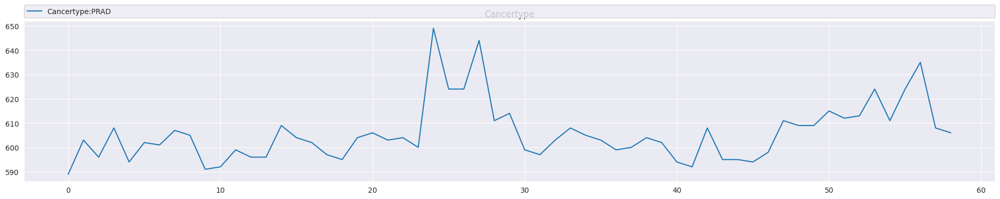

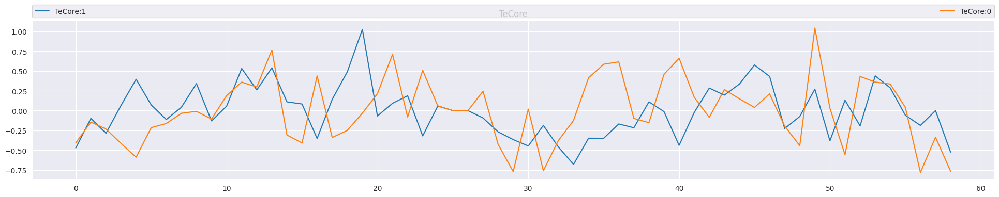

In [33]:
ca.pl.plot_layer(ind.chr, 'CNVAR', chr=19, groups={'Cancertype':['PRAD']}, normal_y=False, reduction='sum')
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=19, resolutions=[1e06], groups={'TeCore':[1, 0]}, quantile_normalized_y=False, normal_y=False, reduction='mean')

### Add filter to be able to query samples

In [191]:
ind.chr.add_filter('Human', encode_biosamples, layers = ['Encode'], resolution=RESOLUTION)
ind.chr.add_filter('Sex', encode_sex, layers = ['Encode'], resolution=RESOLUTION)
ind.chr.add_filter('Organ', encode_organ, layers = ['Encode'], resolution=RESOLUTION)
ind.chr.add_filter('Biosample Classification', encode_bioclass, layers = ['Encode'], resolution=RESOLUTION)

In [20]:
ind.genome.add_filter('TeCore', GTeCore_filter, layers = ['TEs', 'Cores'], index=index, test_res=test_res)

In [180]:
ind.chr.groups[1e06]['Cores']['TeCore']

{'condition': {1: array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         

In [21]:
ind.chr.differentiate_layers(['TEs', 'Cores'], scale=True)

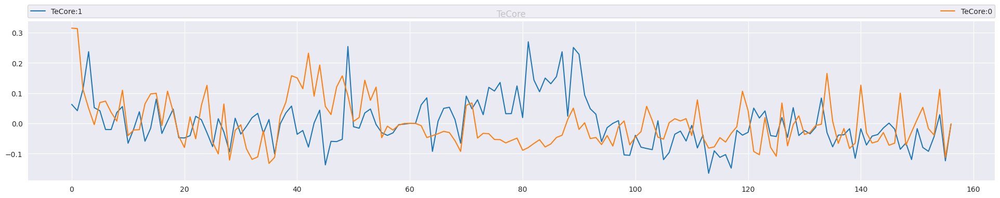

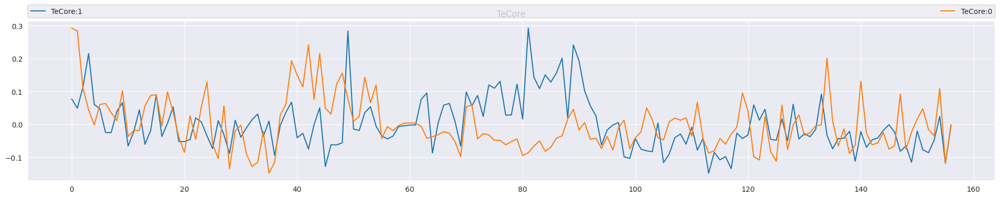

In [22]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolutions=[1e06], groups={'TeCore':[1, 0]}, quantile_normalized_y=False)
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolutions=[1e06], groups={'TeCore':[1, 0]}, quantile_normalized_y=True)

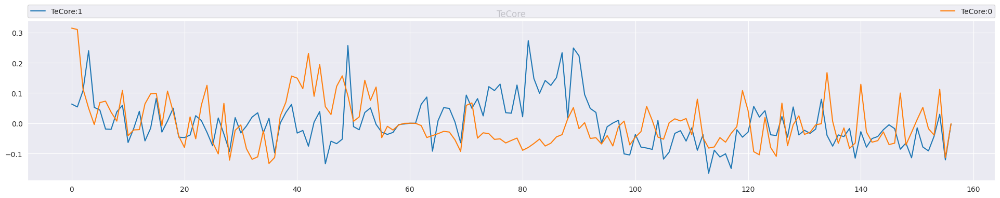

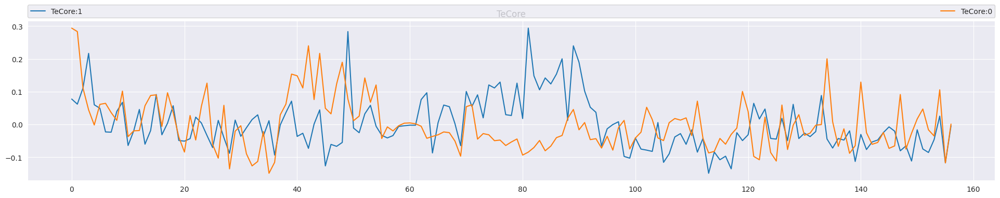

In [190]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolution=1e06, groups={'TeCore':[1, 0]}, quantile_normalized_y=False)
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolution=1e06, groups={'TeCore':[1, 0]}, quantile_normalized_y=True)

## Chromosome X

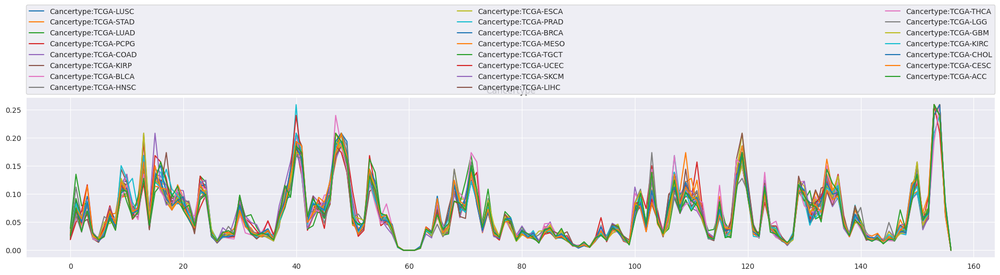

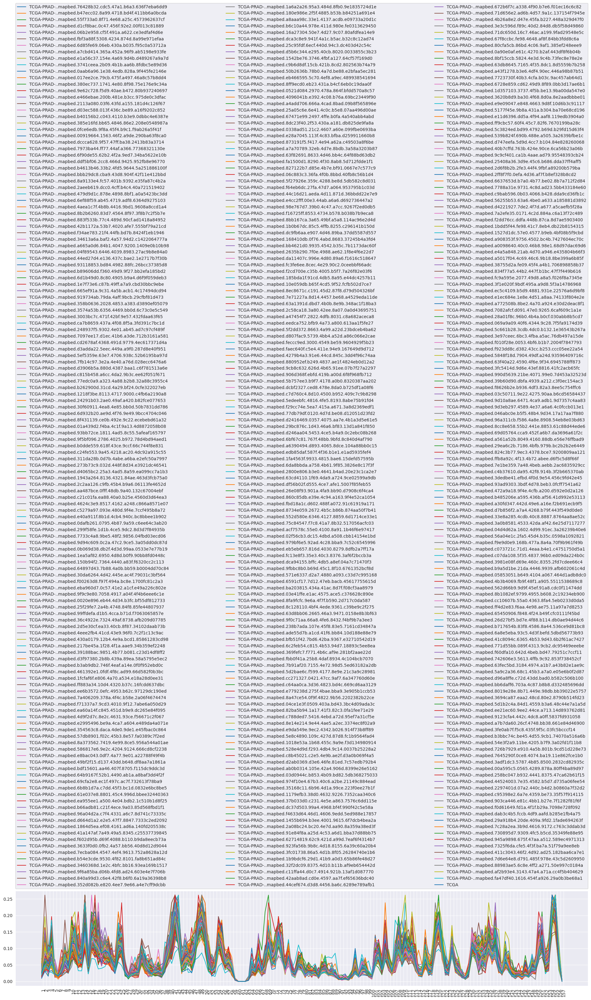

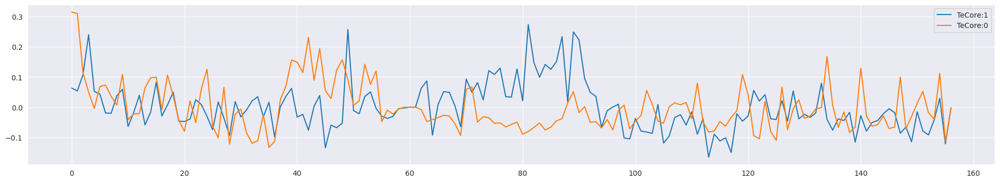

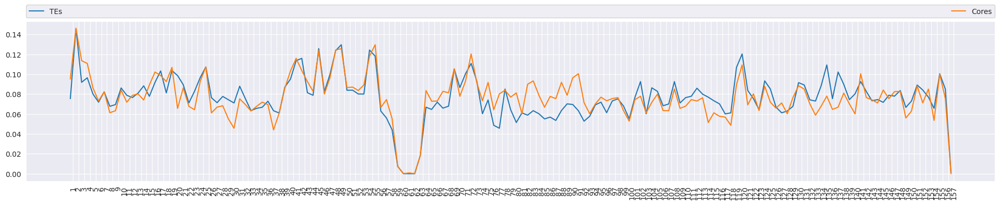

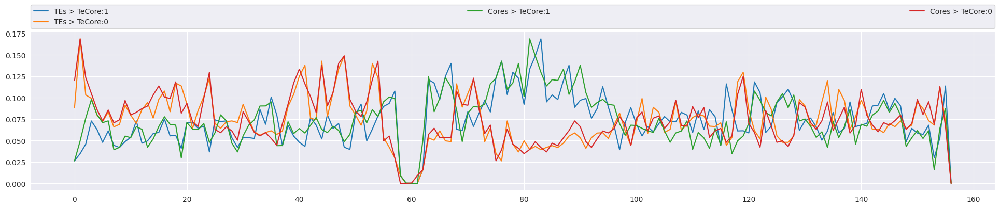

In [237]:
CHR = 'chrX'
ca.pl.plot_layer(ind.chr, 'TCGA', chr=CHR, quantile_normalized_y=True, groups={'Cancertype':[i for i in tcga_met[' Project'].unique()]}, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA')], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, groups={'Cores':{'TeCore':[1, 0]}, 'TEs':{'TeCore':[1, 0]}}, quantile_normalized_y=True)

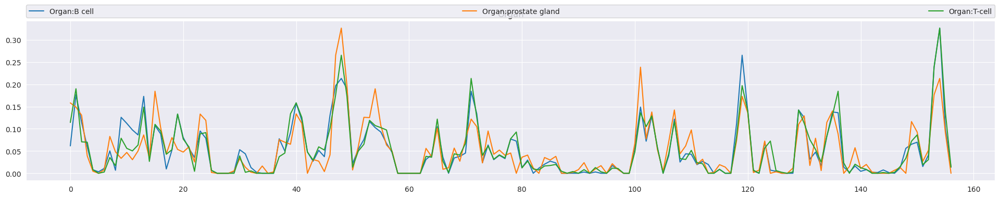

In [283]:
CHR = 'chrX'
# ca.pl.plot_layer(ind.chr, 'TCGA', chr=CHR, quantile_normalized_y=True, groups={'Cancertype':[i for i in tcga_met[' Project'].unique()]}, resolution=RESOLUTION)
ca.pl.plot_layer(ind.chr, 'Encode', chr=CHR, quantile_normalized_y=True, groups={'Organ':['B cell', 'prostate gland', 'T-cell']}, resolution=RESOLUTION)

In [ ]:
# ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA')], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, groups={'Cores':{'TeCore':[1, 0]}, 'TEs':{'TeCore':[1, 0]}}, quantile_normalized_y=True)

## Chromosome 1

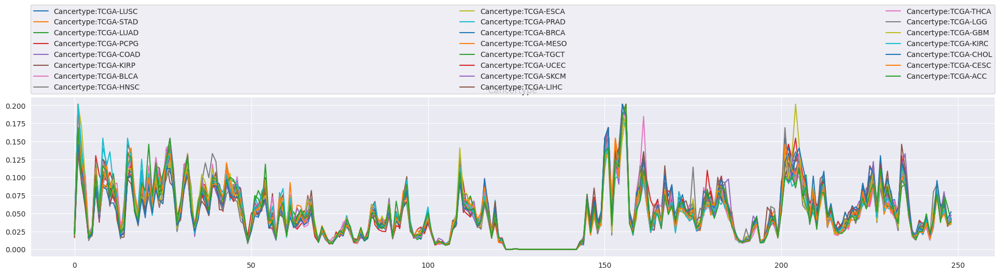

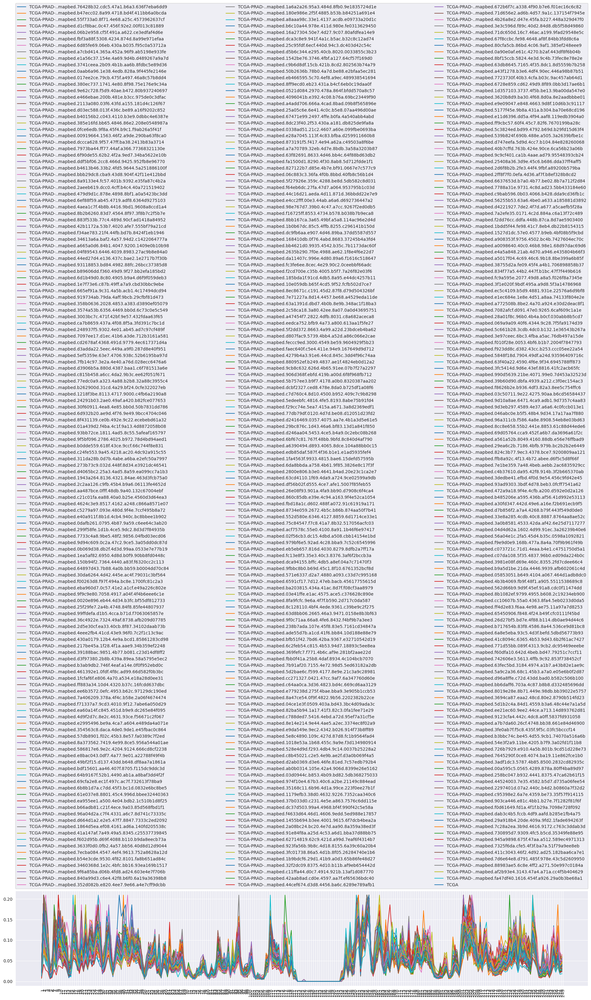

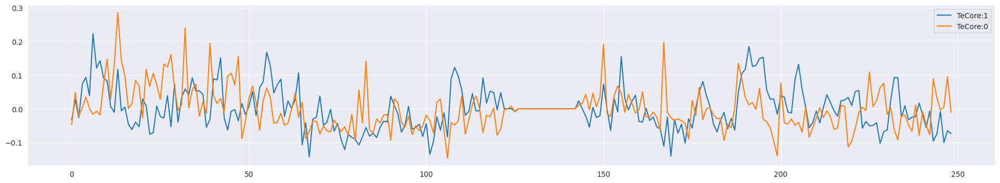

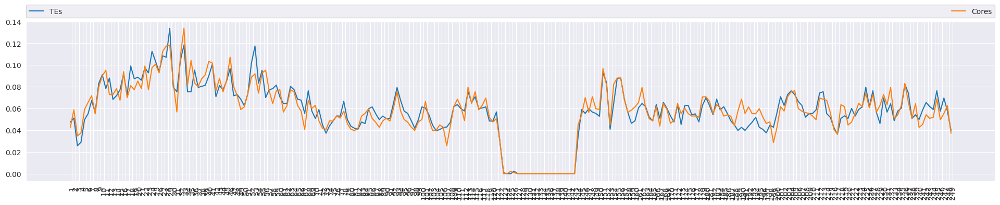

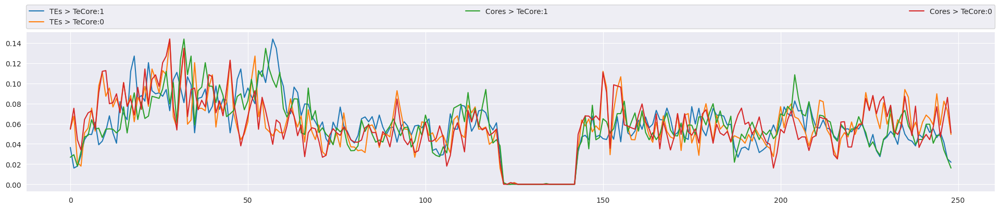

In [238]:
CHR = 'chr1'
ca.pl.plot_layer(ind.chr, 'TCGA', chr=CHR, quantile_normalized_y=True, groups={'Cancertype':[i for i in tcga_met[' Project'].unique()]}, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA')], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, groups={'Cores':{'TeCore':[1, 0]}, 'TEs':{'TeCore':[1, 0]}}, quantile_normalized_y=True)

## Chromosome 19

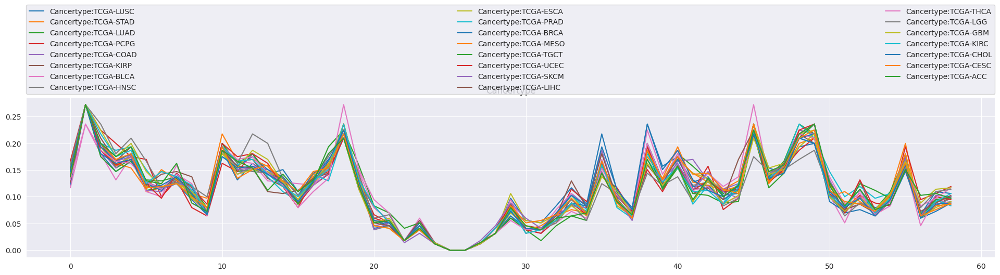

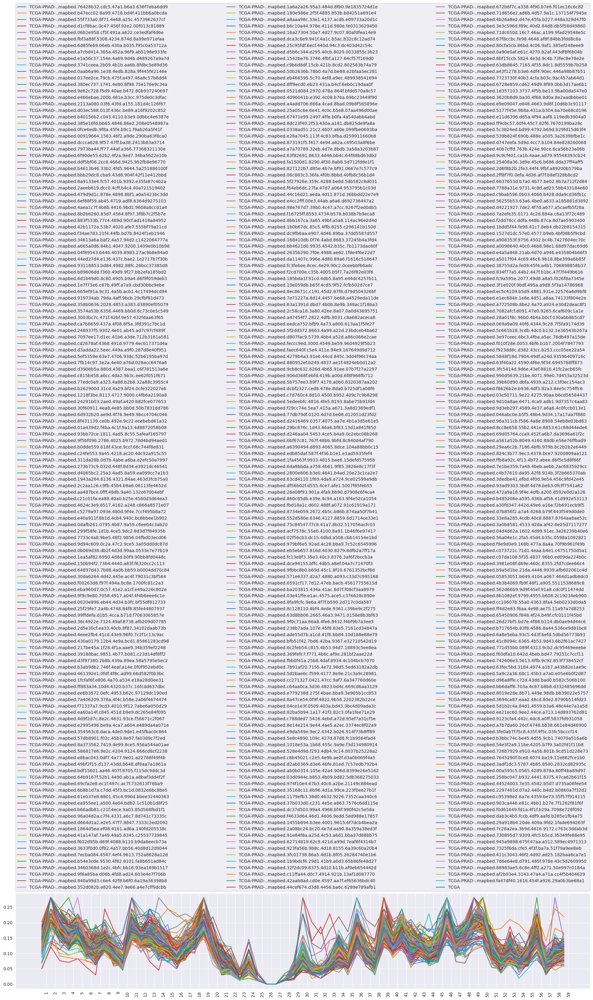

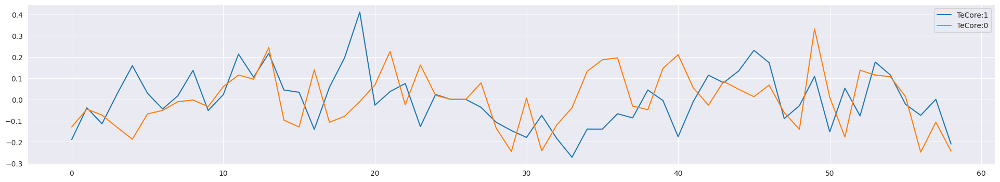

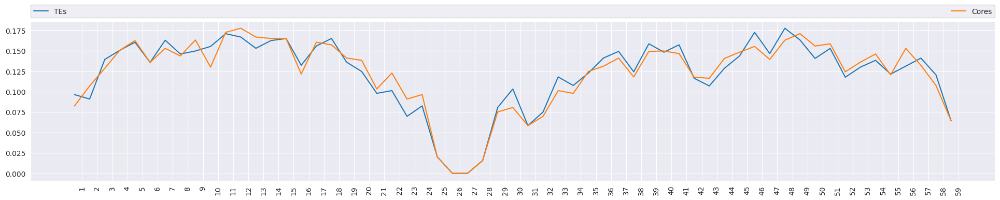

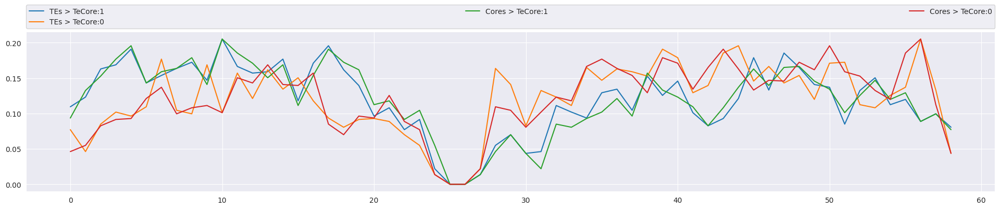

In [239]:
CHR = 'chr19'

ca.pl.plot_layer(ind.chr, 'TCGA', chr=CHR, quantile_normalized_y=True, groups={'Cancertype':[i for i in tcga_met[' Project'].unique()]}, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA')], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, groups={'Cores':{'TeCore':[1, 0]}, 'TEs':{'TeCore':[1, 0]}}, quantile_normalized_y=True)

## Chromosome 8

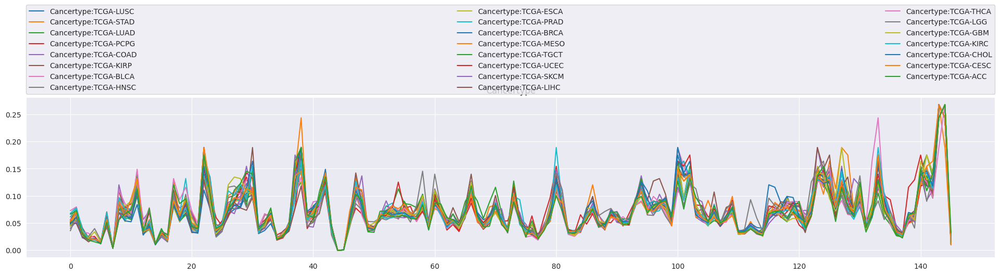

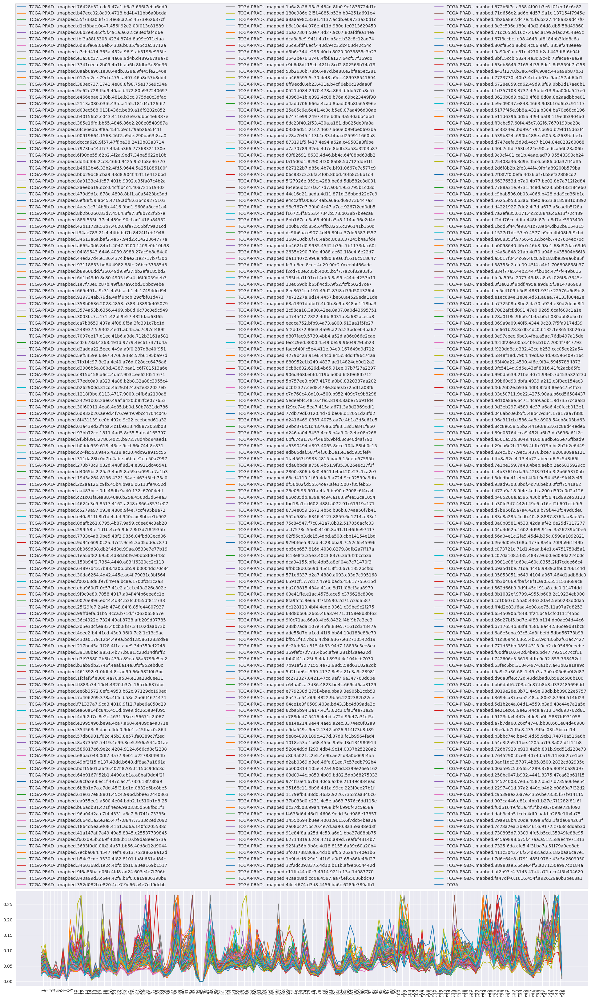

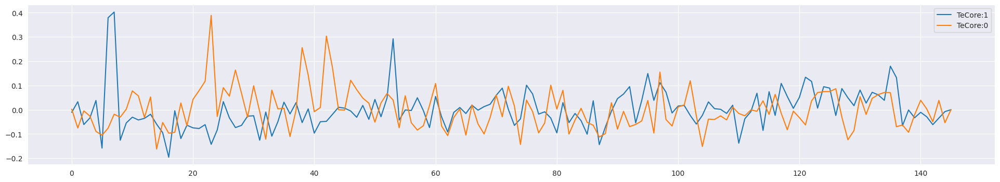

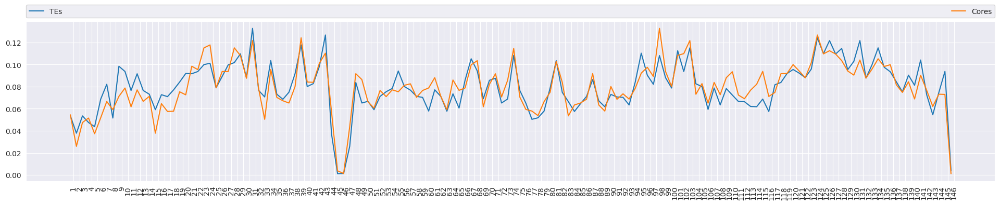

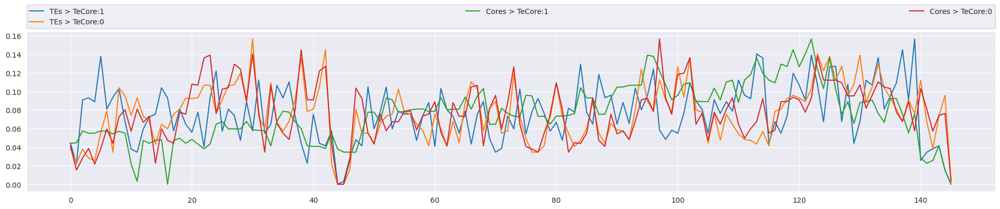

In [240]:
CHR = 'chr8'

ca.pl.plot_layer(ind.chr, 'TCGA', chr=CHR, quantile_normalized_y=True, groups={'Cancertype':[i for i in tcga_met[' Project'].unique()]}, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA')], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, quantile_normalized_y=True)
ca.pl.match_layers(ind.chr, ['TEs', 'Cores'], chr=CHR, log_y=False, resolution=RESOLUTION, groups={'Cores':{'TeCore':[1, 0]}, 'TEs':{'TeCore':[1, 0]}}, quantile_normalized_y=True)

# 10 Mega Base Pair RESOLUTION

## Add layers to ind object 

### Number of Transpose elements

In [38]:
ind.add_layer("TEs", input='/cluster/home/t124771uhn/data/V2-TEs/non_olap/', resolution=RESOLUTION)

loading files from: /cluster/home/t124771uhn/data/V2-TEs/non_olap/


100%|██████████| 975/975 [00:23<00:00, 41.41it/s]


### Number of CREAM Cores

In [22]:
ind.add_layer("Cores", input='/cluster/home/t124771uhn/data/V2-TEs/non_olap/cores1000/', resolution=RESOLUTION)

loading files from: /cluster/home/t124771uhn/data/V2-TEs/non_olap/cores1000/


100%|██████████| 455/455 [00:02<00:00, 214.66it/s]


### TCGA ATAC Signal

In [224]:
tcga = pd.read_csv('/cluster/home/t124771uhn/data/TCGA_ATAC/normalized_consensus_TCGA_signal.counts', nrows=1, sep='\t')
tcga_met = pd.read_csv('/cluster/home/t124771uhn/data/TCGA_ATAC/GDC_metadata.tsv', sep='\t')

In [225]:
feature_columns = tcga_met[tcga_met[' Project']==CANCER_TYPE]['File Name'].apply(lambda x: np.where([x.split('_')[0].split('-')[-1] in i for i in tcga.columns])[0][0]).values

In [226]:
ind.add_layer("TCGA", input='/cluster/projects/lupiengroup/People/mossi/data/TCGA/ATAC', resolution=RESOLUTION, index_mapper=tcga_mapping, feature_type='signal')

Processing file: 100%|█████████▉| 14.9G/14.9G [03:27<00:00, 71.8MB/s]


#### add Number of Oncogenes as a Signal

In [227]:
ind.add_layer('PRAD-cdriver', sub_cdriver, resolution=RESOLUTION)

### Number of TCGA Mutations

In [228]:
ind.add_layer('TCGA-Mutations', '/cluster/projects/lupiengroup/data/public_data/TCGA_hg38_maf/TCGA-PRAD.maf.gz.tcga.maf.bed', resolution=RESOLUTION, feature_type='count')

Processing file: 100%|██████████| 648k/648k [00:00<00:00, 5.99MB/s]


### Encode ATAC Signal

In [20]:
ind.add_layer('Encode', input='/cluster/projects/lupiengroup/People/mossi/data/encode/bedfiles/subset', feature_columns=[6], file_format='gz', feature_type='signal', resolution=RESOLUTION)

loading files from: /cluster/projects/lupiengroup/People/mossi/data/encode/bedfiles/subset



100%|██████████| 4/4 [00:03<00:00,  1.05it/s]


--------

## Add anlytical layer

### Add filter to be able to query samples

In [275]:
ind.chr.add_filter('Human', encode_biosamples, layers = ['Encode'], resolution=RESOLUTION)

In [276]:
ind.chr.add_filter('Sex', encode_sex, layers = ['Encode'], resolution=RESOLUTION)

In [232]:
ind.chr.add_filter('Organ', encode_organ, layers = ['Encode'], resolution=RESOLUTION)

In [233]:
ind.chr.add_filter('Biosample Classification', encode_bioclass, layers = ['Encode'], resolution=RESOLUTION)

In [160]:
ind.chr.add_filter('TeCore', CTeCore_filter, layers = ['TEs', 'Cores'], index=index, test_res=test_res)

In [40]:
ind.genome.add_filter('TeCore', GTeCore_filter, layers = ['TEs', 'Cores', 'Cores-TEs'], index=index, test_res=test_res, resolution=RESOLUTION)

In [297]:
RESOLUTION = 1e06

In [303]:
ind.chr.differentiate_layers(['TEs', 'Cores'], quantile_normalized_y=True, resolution=RESOLUTION)

In [109]:
ind.chr.add_filter('TeCore', CTeCore_filter, layers = ['TEs', 'Cores', 'Cores-TEs'], index=index, test_res=test_res, resolution=RESOLUTION)
ind.genome.add_filter('TeCore', GTeCore_filter, layers = ['TEs', 'Cores-TEs'], index=index, test_res=test_res, resolution=RESOLUTION)

### Add Analytical Layer to chr Omic

In [307]:
ind.chr.differentiate_layers(['TEs', 'Cores'], resolution=RESOLUTION)

In [308]:
ind.chr.correlate_layers(['TEs', 'Cores', 'Cores-TEs'], chr=23, groups={'Cores-TEs':{'TeCore':[1, 0]}}, resolution=1e06, method='all', pairing='all')

TEs
Cores
Cores-TEs
TeCore:1
TeCore:0
['Cores-TEs>542_L1MA1_Merged.bed' 'Cores-TEs>630_L1PA8_Merged.bed'
 'Cores-TEs>631_L1PB1_Merged.bed' 'Cores-TEs>632_L1PB2_Merged.bed'
 'Cores-TEs>633_L1PB3_Merged.bed' 'Cores-TEs>634_L1PB4_Merged.bed'
 'Cores-TEs>636_L1PBa_Merged.bed' 'Cores-TEs>638_L1PB_Merged.bed']



100%|██████████| 3/3 [00:11<00:00,  3.89s/it]

dict_items([('cosine_sim', array([[0. , 0.5, 1. , 0.6, 0.1, 0.2, 0.4, 1. , 0.3, 1. , 0.7, 0.9, 0.1,
        0.2, 0.4, 0.5, 0.8, 0.3, 0.3, 0.7, 0.7, 0. , 1. , 0. , 0.7, 0.9,
        0.8, 1. , 1. ],
       [0.4, 0. , 0.4, 0.8, 1. , 0.1, 0.1, 0. , 0. , 1. , 0.6, 0.6, 0. ,
        0.1, 0.7, 0.8, 0.2, 0.1, 0.5, 0.8, 0.8, 0.7, 0.9, 0.1, 0.6, 0.3,
        1. , 0.7, 1. ],
       [0.7, 0.5, 0. , 1. , 0.8, 0.6, 0.7, 0. , 0.1, 1. , 1. , 0.9, 0. ,
        0.7, 0. , 1. , 0.2, 0.1, 1. , 1. , 0.5, 0. , 1. , 1. , 0.6, 0.5,
        1. , 0.8, 1. ],
       [0.4, 0.8, 1. , 0. , 1. , 0.8, 0.6, 1. , 1. , 0.3, 0. , 1. , 1. ,
        0.6, 1. , 0. , 0.5, 1. , 1. , 0.3, 0.8, 0.8, 0. , 0.5, 0.1, 1. ,
        0. , 1. , 1. ],
       [0. , 1. , 1. , 1. , 0. , 0.3, 0.5, 0.8, 0.9, 0. , 0.8, 0.1, 0.9,
        0.3, 0. , 1. , 0.6, 0.7, 0. , 0.4, 0.4, 0.1, 1. , 0.1, 0.5, 0.2,
        0.5, 1. , 1. ],
       [0.1, 0.3, 0.4, 0.9, 0.1, 0. , 0.8, 0.9, 0.1, 1. , 0.8, 0.9, 0.7,
        1. , 0.9, 0.8, 0.3, 0.9, 0.9, 0.4, 1. , 0.

/cluster/home/t124771uhn/miniconda3/envs/shirin/lib/python3.9/site-packages/seaborn/matrix.py:530: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/cluster/home/t124771uhn/miniconda3/envs/shirin/lib/python3.9/site-packages/seaborn/matrix.py:615: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set_xlim(0, max_dependent_coord * 1.05)
/cluster/home/t124771uhn/miniconda3/envs/shirin/lib/python3.9/site-packages/seaborn/matrix.py:530: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/cluster/home/t124771uhn/miniconda3/envs/shirin/lib/python3.9/site-packages/seaborn/matrix.py:623: UserWarning: Attempting to set identical 

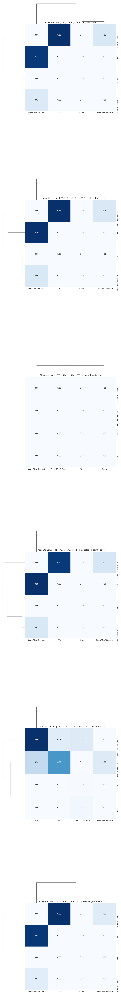

In [102]:
ca.pl.correlate_layers(ind.chr, ['TEs', 'Cores', 'Cores-TEs'], chr=1, groups={'Cores-TEs':{'TeCore':[1, 0]}}, resolution=1e06, method='all', scale_factor=4)

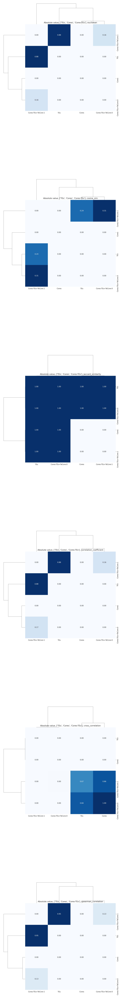

In [87]:
ca.pl.correlate_layers(ind.chr, ['TEs', 'Cores', 'Cores-TEs'], chr=23, groups={'Cores-TEs':{'TeCore':[1, 0]}}, resolution=1e06, method='all', scale_factor=4)

## Chromosome X

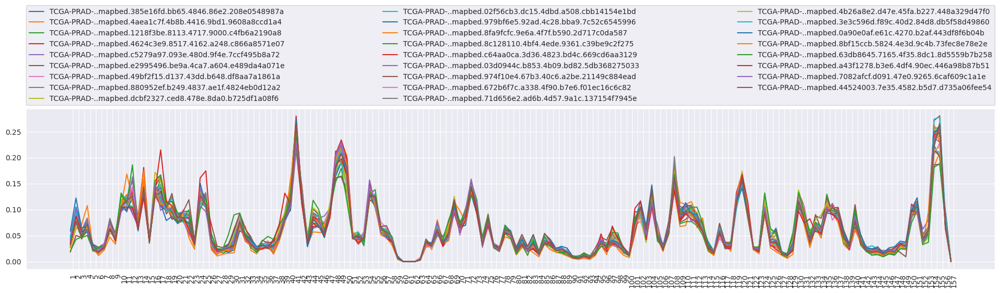

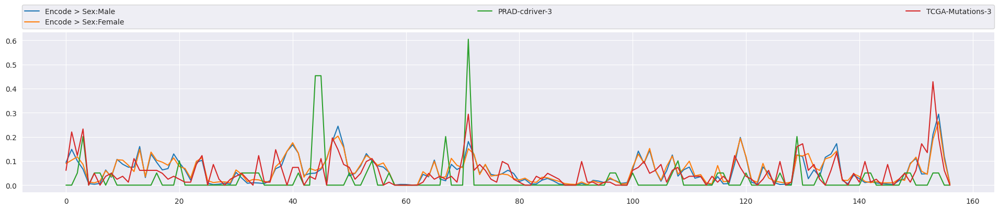

In [280]:
CHR = 'chrX'

ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA-PRAD-.')], chr=CHR, log_y=False, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'PRAD-cdriver-3','TCGA-Mutations-3'], groups={'Encode':{'Sex':['Male', 'Female']}}, chr=CHR, log_y=False, resolution=RESOLUTION, group_plots=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION)

## Chromosome 1

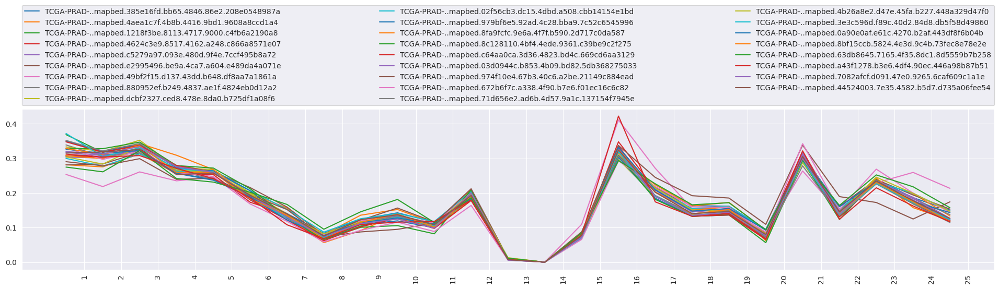

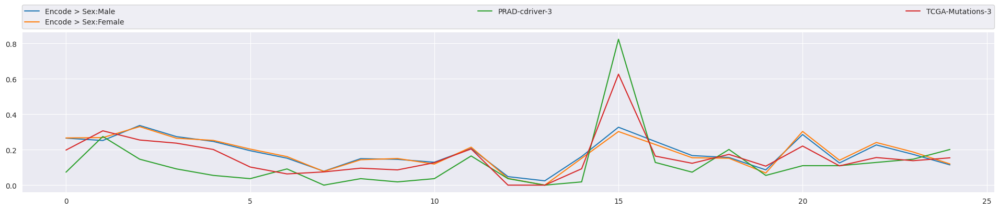

In [68]:
CHR = 'chr1'
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA-PRAD-.')], chr=CHR, log_y=False, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'PRAD-cdriver-3','TCGA-Mutations-3'], groups={'Encode':{'Sex':['Male', 'Female']}}, chr=CHR, log_y=False, resolution=RESOLUTION, group_plots=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION)

## Chromosome 19

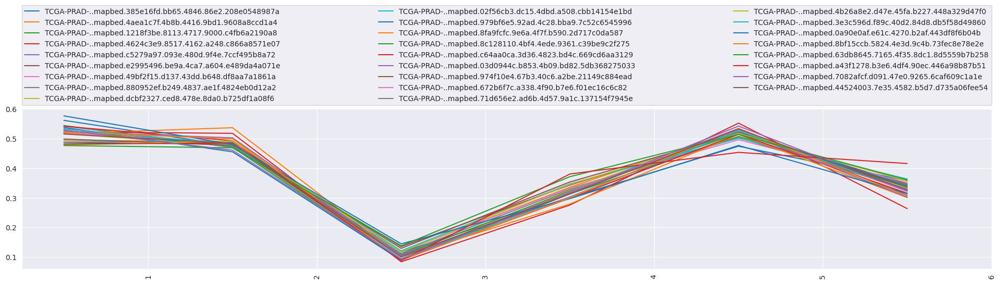

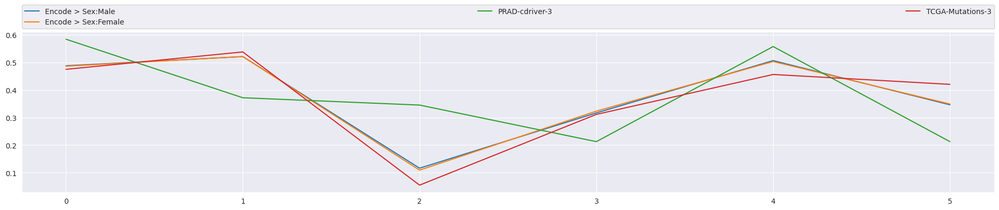

In [69]:
CHR = 'chr19'

ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA-PRAD-.')], chr=CHR, log_y=False, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'PRAD-cdriver-3','TCGA-Mutations-3'], groups={'Encode':{'Sex':['Male', 'Female']}}, chr=CHR, log_y=False, resolution=RESOLUTION, group_plots=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION)

## Chromosome 17

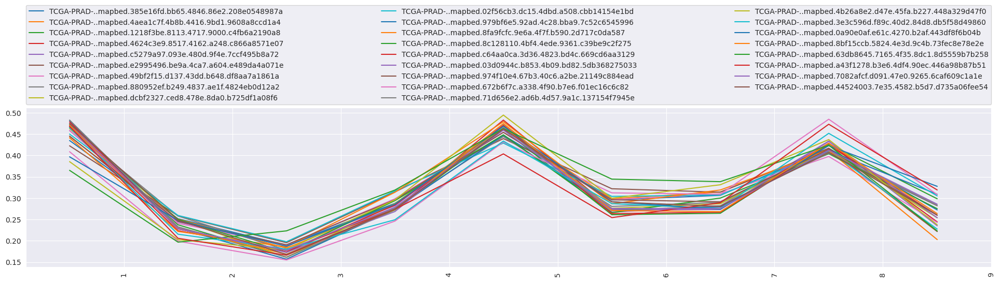

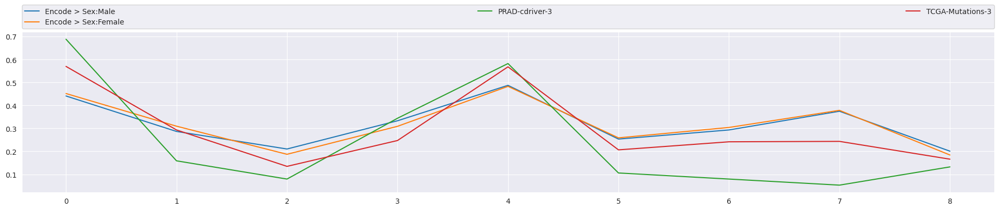

In [70]:
CHR = 'chr17'
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA-PRAD-.')], chr=CHR, log_y=False, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'PRAD-cdriver-3','TCGA-Mutations-3'], groups={'Encode':{'Sex':['Male', 'Female']}}, chr=CHR, log_y=False, resolution=RESOLUTION, group_plots=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION)

## Chromosome 8

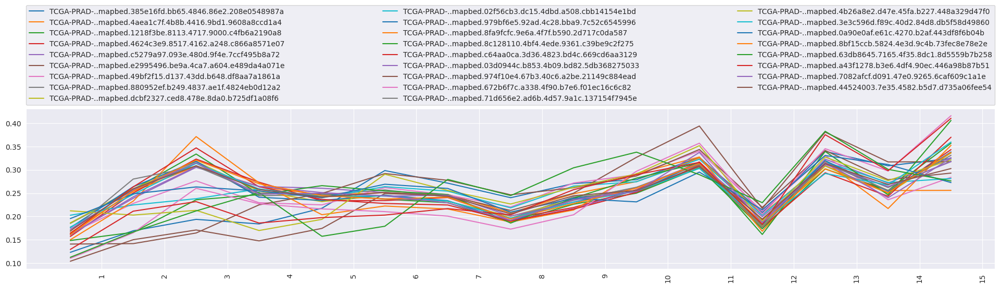

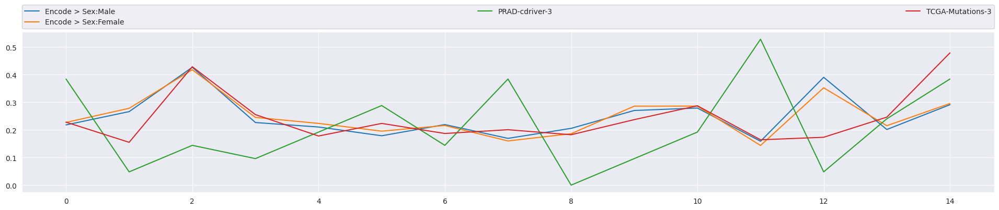

In [71]:
CHR = 'chr8'

ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA-PRAD-.')], chr=CHR, log_y=False, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'PRAD-cdriver-3','TCGA-Mutations-3'], groups={'Encode':{'Sex':['Male', 'Female']}}, chr=CHR, log_y=False, resolution=RESOLUTION, group_plots=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION)

## Chromosome 1

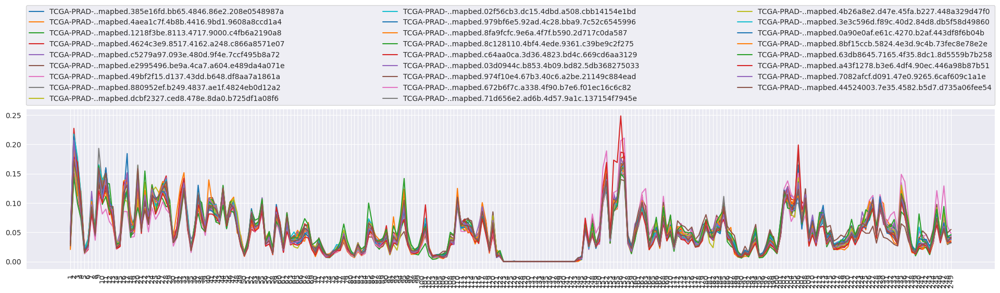

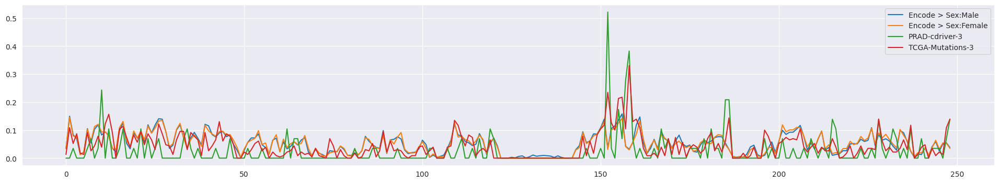

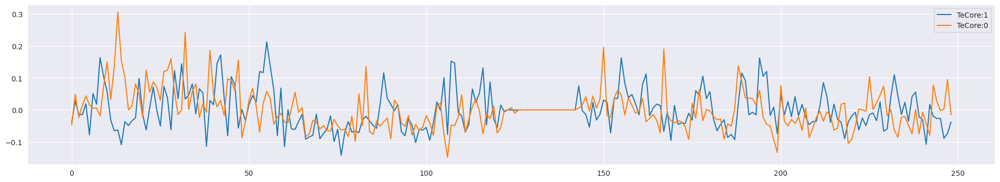

In [67]:
CHR= 'chr1'
ca.pl.match_layers(ind.chr, [i for i in ind.chr.layers[RESOLUTION].keys() if i.startswith('TCGA-PRAD-.')], chr=CHR, log_y=False, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'PRAD-cdriver-3','TCGA-Mutations-3'], groups={'Encode':{'Sex':['Male', 'Female']}}, chr=CHR, log_y=False, resolution=RESOLUTION, group_plots=True)
ca.pl.differentiate_layers(ind.chr, ['TEs', 'Cores'], groups={'TeCore':[1, 0]}, chr=CHR, resolution=RESOLUTION)

## Plot Layers

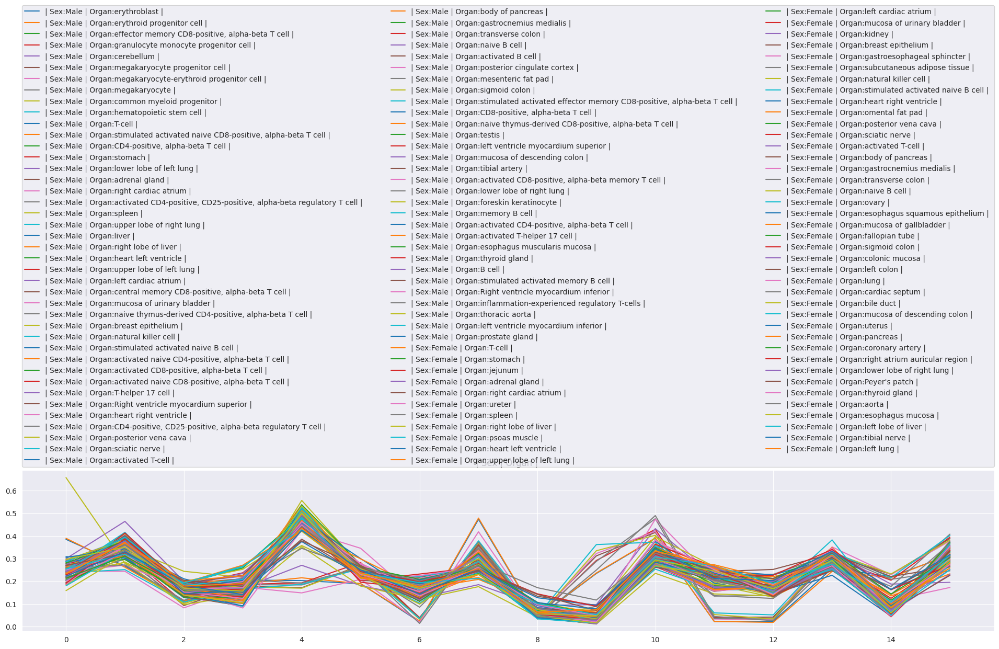

In [259]:
df = ca.pl.plot_layer(ind.chr, 'Encode', chr=23, groups={'Sex':['Male', 'Female'], 'Organ':[i for i in ind.chr.groups[1e07]['Encode']['Organ']['annotation'][1].values()]}, log_y=False, resolution=RESOLUTION, return_value=False, group_plots=False)

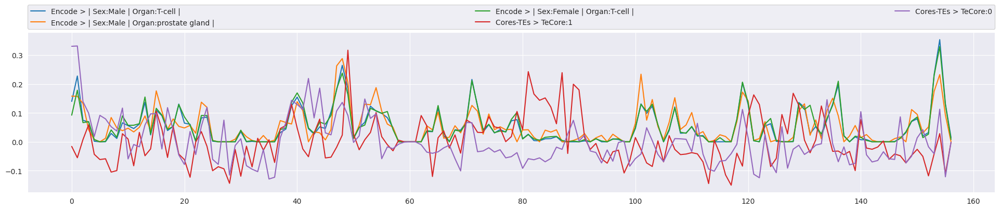

In [283]:
CHR = 'chrX'
d = ca.al.signal_correlation(ind.chr, ['Encode', 'Cores-TEs'], groups={'Encode':{'Sex':['Male', 'Female'], 'Organ':['T-cell', 'prostate gland']}, 'Cores-TEs':{'TeCore':[1, 0]}}, chr=CHR, resolution=RESOLUTION)
ca.pl.match_layers(ind.chr, ['Encode', 'Cores-TEs'], groups={'Encode':{'Sex':['Male', 'Female'], 'Organ':['T-cell', 'prostate gland']}, 'Cores-TEs':{'TeCore':[1, 0]}}, chr=CHR, resolution=RESOLUTION)

In [77]:
def layer_class(layer):
    return np.any([i in layer for i in ['Encode', 'TCGA']])

In [ ]:
def encode_organ(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {i:v for i, v in enumerate(meta_encode['Biosample term name'].unique())}
    mapping = {v:i for i, v in enumerate(meta_encode['Biosample term name'].unique())}
    org = meta_encode.loc[:, ['Files', 'Biosample term name']]
    for chr in range(1, 25):
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [mapping[org[org['Files'].apply(lambda x: sample.split('.bed.gz')[0] in x)]['Biosample term name'].values[0]] for sample in samples]
        annotations[chr] = ann
    return conditions, annotations

In [192]:
def get_cancertype(chromosome_layer, **kwargs):
    conditions = {}
    annotations = {}
    ann = {i:v for i, v in enumerate(tcga_met[' Project'].unique())}
    mapping = {v:i for i, v in enumerate(tcga_met[' Project'].unique())}
    for chr in ca.info.CHROMOSOMES['numericals'].values():
        samples = chromosome_layer['index'][chr]
        conditions[chr] = [mapping[i.split('_')[0]] for i in ind.chr.layers[1e06]['TCGA']['index'][chr]]
        annotations[chr] = ann
    return conditions, annotations

ind.chr.add_filter('Cancertype', get_cancertype, ['TCGA'], resolution=RESOLUTION)

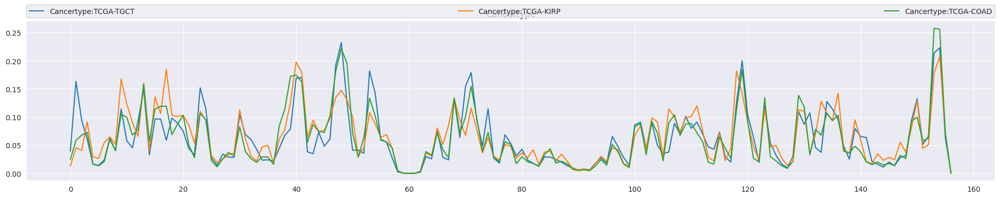

In [193]:
ca.pl.plot_layer(ind.chr, 'TCGA', groups={'Cancertype':['TCGA-TGCT', 'TCGA-KIRP', 'TCGA-COAD']}, resolution=1e06, chr=23)

In [109]:
RESOLUTION = 1e06
CHR = 'chrX'
ind.chr.correlate_layers(['Encode', 'Cores-TEs', 'TCGA'],
                         groups={'Encode':{'Sex':['Male', 'Female'], 'Organ':['T-cell', 'prostate gland']}, 'Cores-TEs':{'TeCore':[1, 0]}, 'TCGA':{'Cancertype':['TCGA-TGCT', 'TCGA-KIRP', 'TCGA-COAD']}}, 
                         chr=CHR, 
                         reduce_dim=True, 
                         resolution=RESOLUTION,  
                         method='all', 
                         classifier=layer_class,
                         pairing = 'all',
                         compare_method='similarity',
                         qnormal=True)

100%|██████████| 3/3 [04:35<00:00, 91.93s/it]


In [61]:
ind.chr.layers[1e06].keys()

odict_keys(['TEs', 'Cores', 'TCGA', 'co', 'Encode'])

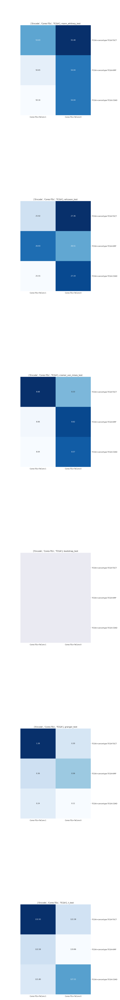

In [201]:
ca.pl.correlate_layers(ind.chr, ['Encode', 'Cores-TEs', 'TCGA'], groups={'Encode':{'Sex':['Male', 'Female'], 'Organ':['T-cell', 'prostate gland']}, 'Cores-TEs':{'TeCore':[1, 0]}}, scale_factor=3, dendrogram=False, resolution=1e06, method='all')

In [ ]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolution=1e07, normal_y=False, quantile_normalized_y=True)

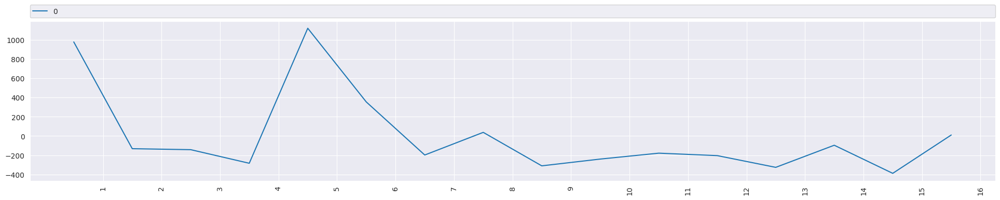

In [108]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolution=1e07, normal_y=False, quantile_normalized_y=True)

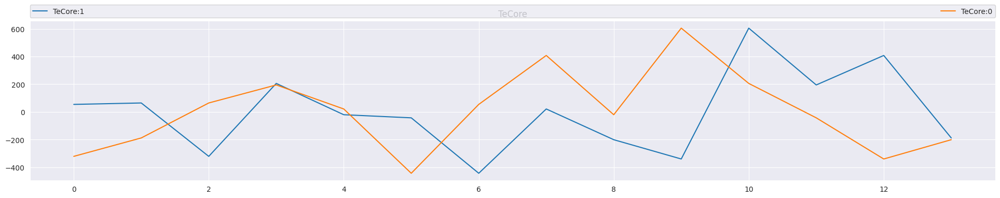

In [126]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=10, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)


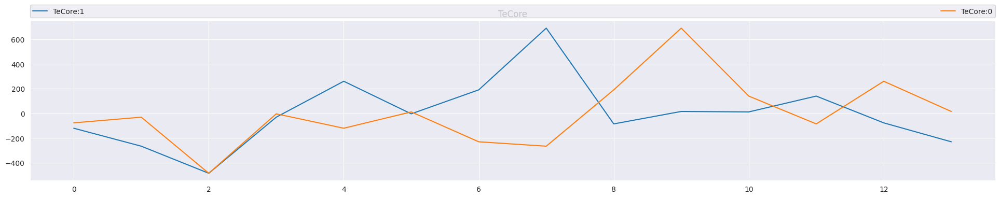

In [125]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=9, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)


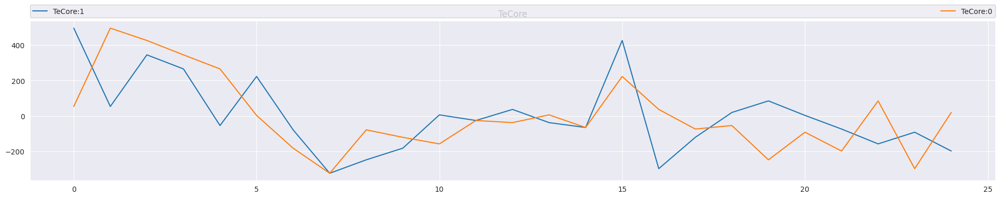

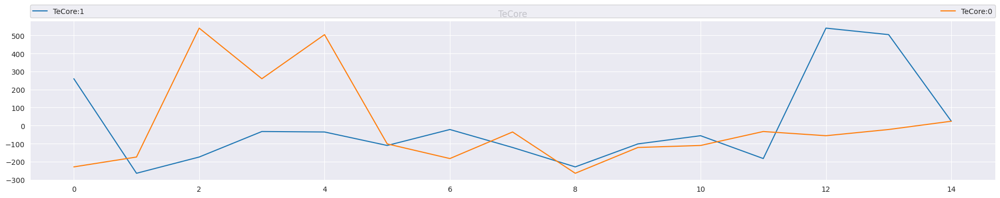

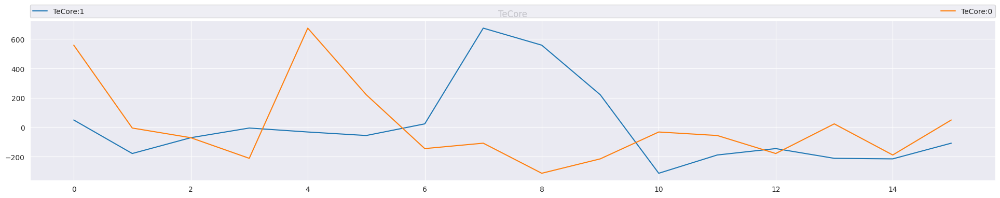

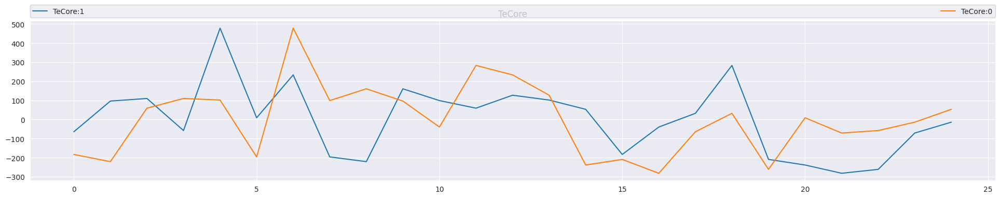

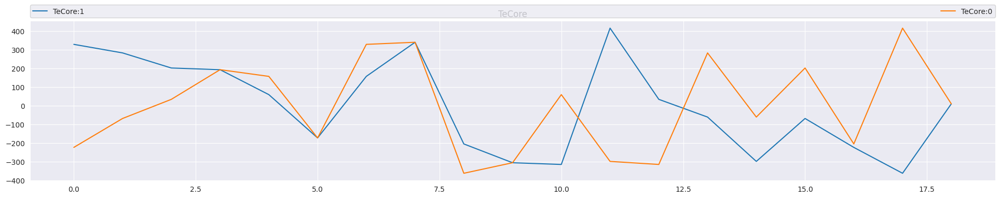

In [124]:
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=1, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=8, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=23, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=2, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores-TEs', chr=5, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)


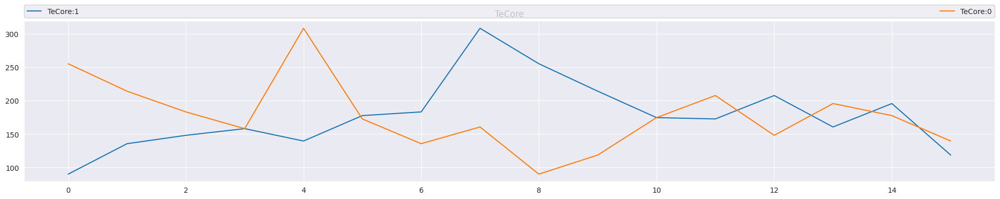

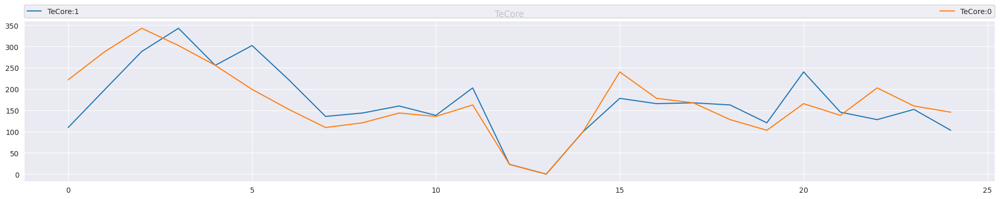

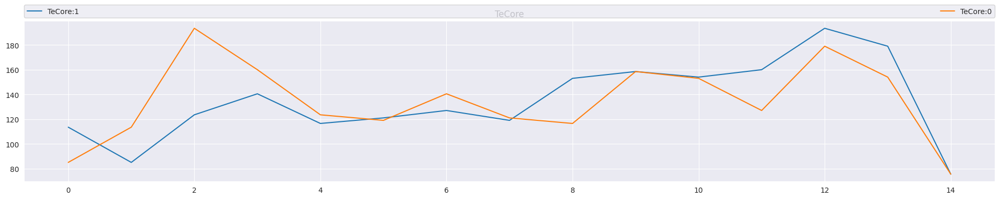

In [105]:
ca.pl.plot_layer(ind.chr, 'Cores', chr=23, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores', chr=1, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores', chr=8, resolution=1e07, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)

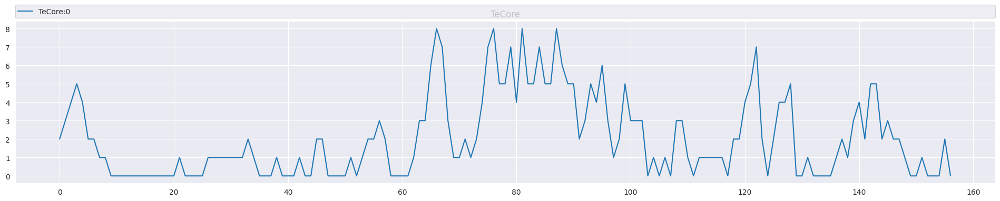

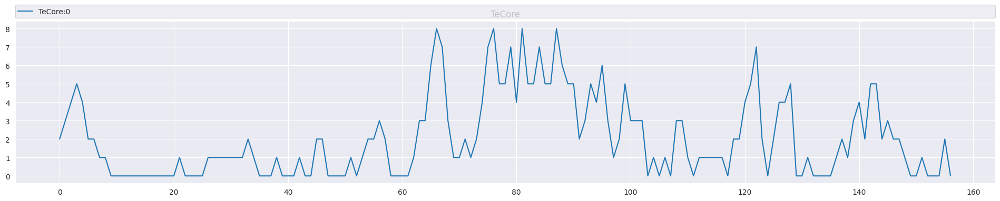

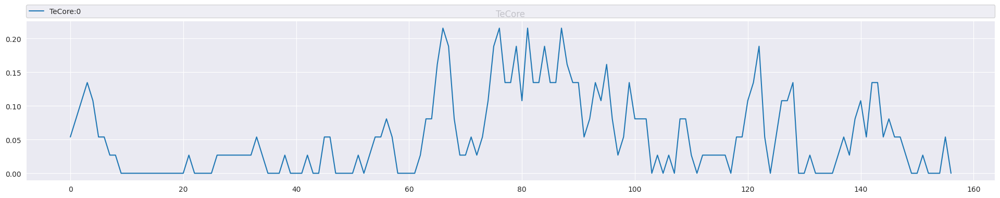

In [118]:
ca.pl.plot_layer(ind.chr, 'Cores', chr=23, resolution=RESOLUTION, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=False)
ca.pl.plot_layer(ind.chr, 'Cores', chr=23, resolution=RESOLUTION, groups={'TeCore':[1, 0]}, normal_y=False, quantile_normalized_y=True)
ca.pl.plot_layer(ind.chr, 'Cores', chr=23, resolution=RESOLUTION, groups={'TeCore':[1, 0]}, normal_y=True, quantile_normalized_y=False)

<AxesSubplot: >

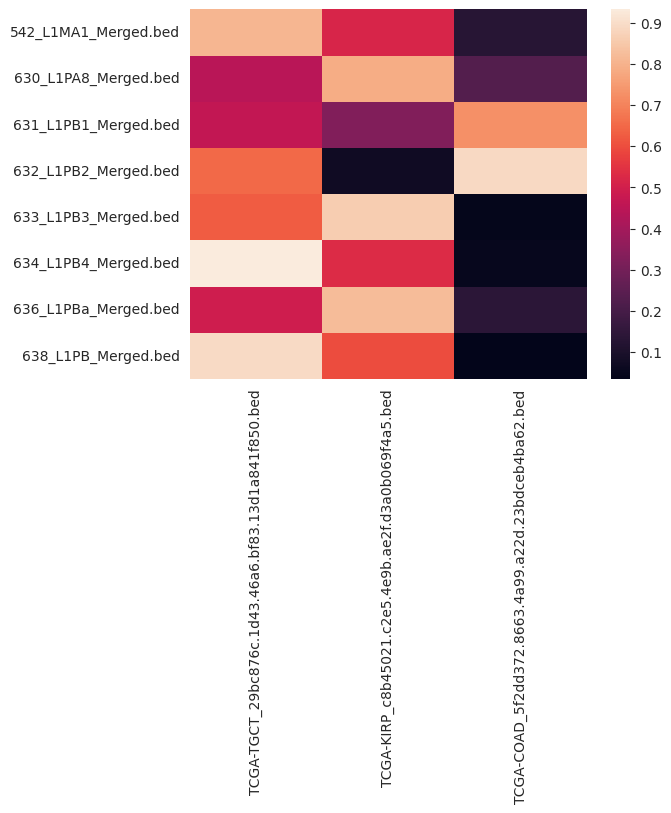

In [129]:
sns.heatmap(ind.chr.layers[1e06]['co'][('TCGA',
  'Cores-TEs',
  'Encode')]['pvalue']['cosine_sim'])

In [353]:
ind.chr.correlate_layers(['TEs', 'Cores'], chr=23, resolution=RESOLUTION, by='index', method='all', pairing='all', groups={'TEs':{'COTE':[1], 'TeCore':[0, 1]}, 'Cores':{'TeCore':[0, 1]}}, classifier=lambda x: 'TCGA' in x, qnormalize=True)

TEs
| COTE:1 | TeCore:0 | 
['TE>638_L1PB_Merged.bed' 'TE>631_L1PB1_Merged.bed'
 'TE>542_L1MA1_Merged.bed' 'TE>630_L1PA8_Merged.bed'
 'TE>643_L2a_Merged.bed' 'TE>632_L1PB2_Merged.bed'
 'TE>635_L1PBa1_Merged.bed' 'TE>636_L1PBa_Merged.bed'
 'TE>637_L1PBb_Merged.bed' 'TE>634_L1PB4_Merged.bed'
 'TE>639_L1P_Merged.bed' 'TE>633_L1PB3_Merged.bed']

| COTE:1 | TeCore:1 | 
Cores
TeCore:0
['COTES>638_L1PB_Merged.bed' 'COTES>631_L1PB1_Merged.bed'
 'COTES>542_L1MA1_Merged.bed' 'COTES>630_L1PA8_Merged.bed'
 'COTES>632_L1PB2_Merged.bed' 'COTES>636_L1PBa_Merged.bed'
 'COTES>642_L2-3_Crp_Merged.bed' 'COTES>634_L1PB4_Merged.bed'
 'COTES>633_L1PB3_Merged.bed']

TeCore:1


100%|██████████| 3/3 [00:01<00:00,  2.11it/s]


<AxesSubplot: >

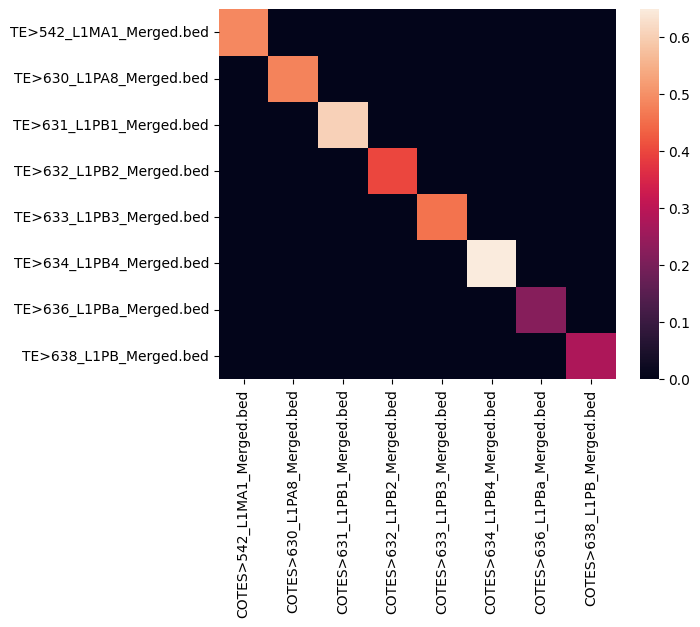

In [177]:
sns.heatmap(dfs, fmt=".1f")